<a href="https://colab.research.google.com/github/hindhammad24/NLP-Week2-Text-Generation/blob/main/computervisionproject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NutriGuide** - Health Nutrition RAG Chatbot
**By Hind Hammad and Manmeet Sagri**

**Project Overview**

In our project, we are creating NutriGuide, a Retrieval-Augmented Generation (RAG) chatbot designed to give safe, evidence-based nutrition guidance. We built this system because we wanted to create a tool that doesn’t rely on random internet information, but instead pulls directly from trusted health sources like Canada’s Food Guide and the World Health Organization. Our chatbot uses retrieval to gather verified information and a language model to summarize it into clear, simple responses. Since we are focusing on general healthy eating, our system avoids giving medical or extreme diet advice and instead supports users with educational nutrition information.

**Problem**

While working on this project, we realized how difficult it is for people to access reliable nutrition information online. Many websites, influencers, and social media platforms share conflicting or unsafe diet advice, which can easily confuse users. A lot of people end up relying on viral trends instead of evidence-based recommendations. We wanted to solve this problem by building a chatbot that only uses trustworthy public-health information and provides consistent, safe guidance.

**significance**

As we researched different ideas, we quickly saw how much misinformation exists in the nutrition space. This problem felt meaningful to us because we noticed that students, newcomers to Canada, and busy individuals often struggle to identify what is actually healthy or safe. Since we are working with official health sources, our project gives users a way to access dependable information without having to navigate complex government websites. To us, the significance of this project lies in making nutrition education more accessible, culturally neutral, and easier to understand.

**Users/Usecase**

From our perspective, the people who will benefit most from our chatbot are users who want quick, general nutrition guidance without dealing with confusing or unreliable online sources. This includes beginners learning about healthy eating, people who want simple explanations, and anyone who feels overwhelmed by online diet content. We designed the use case to be a straightforward chat interface where users type questions and receive safe, evidence-based responses grounded directly in our dataset.

**where/how they'll be using the model?**

We expect users to interact with our model through a lightweight chatbot interface, either on a web app or through an interactive notebook. Our goal is for people to use it in everyday situations; for example, when planning meals, trying to understand healthy habits, or wanting quick reminders about balanced eating. Since the model retrieves real text from reliable sources, users get accurate information instantly without needing to browse multiple websites.

**what kind of data it requires?**

To build this system, we needed data that is both reliable and allowed for academic use. We collected text from Canada’s Food Guide and WHO Healthy Diet resources because these are publicly available educational materials. We cleaned the text, split it into smaller chunks; and turned it into embeddings so the chatbot can retrieve the right information when a user asks a question. Our model does not collect or store personal user data, it only uses the user’s question to retrieve the correct evidence and generate an answer.


# **Model Source and How We Used It**

For this project, we began by forking the RAG (Retrieval-Augmented Generation) notebook provided by our TA. The original notebook (“Retrieval_Augmented_Generation_(RAG).ipynb”) contained a minimal working example of a RAG pipeline using HuggingFace models. We used this notebook as the foundation for our system and adapted it to our nutrition use case.

Inside the instructor’s notebook, two external models were loaded through the HuggingFace transformers and sentence-transformers libraries:

- DistilGPT-2 (text generation)

- all-MiniLM-L6-v2 (sentence embeddings)



 ### **DistilGPT-2**

Source: HuggingFace model hub

Original Repository: https://huggingface.co/distilgpt2

License: MIT License (allows modification, reuse, and non-commercial/educational deployment)

**How we used it:**

T- he instructor’s notebook loaded DistilGPT-2 using the HuggingFace pipeline("text-generation").

- We kept this part of the code but modified the prompt template so that the model only generates answers using text from our nutrition dataset.

- We added safety rules (no diagnoses, no calories, no meal plans, etc.) and included them in the system prompt.

- DistilGPT-2 then generates short, coherent answers grounded in retrieved evidence.

### **MiniLM-L6-v2**

Source: SentenceTransformers library

Original Repository: https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2

License: Apache 2.0 License (permits research use, modification, and redistribution)

**How we used it**

- In the instructor’s notebook, this model was used to convert the dummy RAG documents into 384-dimensional embeddings.

- We replaced the original placeholder texts with our own dataset, which we created using reliable public health sources (Canada’s Food Guide and WHO Health Diet Facts).

- The embedding model allowed us to perform semantic search and retrieve the top relevant pieces of nutrition evidence for each user question.

### **FAISS Index**

Source: Installed inside the instructor’s notebook (FAISS CPU version)

License: MIT License

Repository: https://github.com/facebookresearch/faiss

**How we used it:**

- FAISS was originally used in the instructor’s example to store embeddings of small RAG documents.

- We kept the same retrieval structure, but instead of the original sample RAG text, we inserted nutrition text chunks.

- This enabled accurate retrieval of relevant information before passing it to the language model.

### **Instructor Notebook**

Provided by: TA

Filename: Retrieval_Augmented_Generation_(RAG).ipynb

**How we used and modified it:**

We forked the entire notebook as the starting point for our project.

We replaced the example documents = [...] list with our nutrition dataset.

We rewrote the generate_with_rag() function to:

- enforce safety guardrails,

- inject public-health context,

- prevent unsafe diet or medical advice,

- cite retrieved information clearly.

- We added a testing framework using real-world diet questions.

- We integrated everything into a simple chatbot interface for deployment.

# **RAG Dataset Description**





## **Overview of the Dataset**

For this project, we created a custom RAG dataset focused on evidence-based nutrition and healthy eating practices. Our goal was to ensure that NutriGuide provides safe, factual, and research-supported information rather than relying on general internet knowledge. The dataset contains information from trusted public-health sources, including Government of Canada dietary guidelines, the World Health Organization (WHO), and the Heart & Stroke Foundation. All documents focus on general healthy eating, nutrient recommendations, dietary patterns, and practical guidance for the public.

The final dataset contains 34 cleaned text files categorized into themes such as vegetables and fruits, whole grains, protein foods, food skills, food marketing, vitamin D, life-stage nutrition, dietary shifts, healthy eating habits, and global nutrition recommendations.

## **Data Collection Process & Source Links**

We manually collected the dataset from publicly available, non-copyrighted educational resources intended for public use. All content came from official health organizations that allow non-commercial academic reuse.

**Main sources used:**

Canada’s Food Guide – Government of Canada
https://food-guide.canada.ca/en/

Canada’s Dietary Guidelines – Health Canada (PDF)
https://www.canada.ca/content/dam/hc-sc/documents/services/food-nutrition/canada-food-guide/resources/canada-food-guide-backgrounder/food-guide-snapshot.pdf

World Health Organization: Healthy Diet
https://www.who.int/news-room/fact-sheets/detail/healthy-diet

Heart & Stroke Foundation – Healthy Eating Basics
https://www.heartandstroke.ca/healthy-living/healthy-eating/healthy-eating-basics

## **How we collected the data**

- We manually copied sections of text from each source.

- We ensured only public information intended for public education was included.

- We avoided copyrighted recipes, menus, or branded content.

- We grouped text into logical sections (e.g., vegetables, protein foods, food marketing).

**How we stored the dataset**

After cleaning each text section, we saved them as individual .txt files and packaged them into a folder, which we uploaded as data.zip for use in our RAG notebook.


# **Data Cleaning & Preprocessing**

The raw text from each website or PDF contained many elements that would interfere with retrieval (menus, buttons, duplicate headings, references, formatting noise). To make the dataset consistent and useful for RAG, we cleaned all text manually.

## **Cleaning steps we applied**

- Removed HTML menus, navigation text, sidebars, “On this page,” and repeated headings.

- Removed unnecessary lists (e.g., “Twitter / Facebook / Share”).

- Removed references, footnotes, citation numbers, and academic formatting.

- Consolidated bullet lists into readable sentences.

- Paraphrased and rewrote large portions for clarity while preserving the original meaning.

- Removed medical advice, prescriptive diet plans, and anything unsafe or diagnostic.

- Split long sections into smaller, topic-based files to improve retrieval accuracy.

- Ensured all wording was neutral, educational, and general, not personalized.

- Ensured no copyrighted text from non-governmental sources was used verbatim.

- All cleaned text files contain short, self-contained paragraphs that the embedding model can index effectively.


# **Naming Convention and File Organization**

To keep the dataset easy to load, search, and maintain, we used a consistent naming system:

**All files are saved as:** source_topic.txt

Examples:

- canada_vegetables_and_fruits.txt

- canada_whole_grains.txt

- canada_protein_foods.txt

- canada_mindful_eating.txt

- who_healthy_diet_key_facts.txt

- who_practical_healthy_eating_tips.txt

- heartstroke_healthy_eating_basics.txt


**Naming rules we followed**

- Lowercase only
- Words separated by underscores
- Prefix shows the source (canada, who, heartstroke)

- Second part describes the topic

- One topic per file for cleaner chunking

The dataset folder contains all .txt files and is stored as data/ in our project directory. We zipped the folder (data.zip) for submission and to make it easy to load inside the Jupyter notebook.

# **Data Preprocessing**



Before training, we performed several basic preprocessing steps to ensure data consistency and model compatibility:

- Removed misplaced images: A few healthy images were found inside the diseased folder (and vice versa). We corrected these manually.

- Verified dataset integrity: We checked that every image file could open successfully and that there were no missing or unreadable files.

- Standardized image naming: Using PowerShell, we renamed all files with the format plant_condition_number (e.g., apple_healthy_1.jpg) to avoid issues caused by spaces or parentheses.

- Folder-based labeling: Because this is a classification task, we did not need to create .txt annotation files. The folder names (“Healthy” and “Diseased”) act as labels, which YOLO automatically reads during training.

These preprocessing steps ensured that our dataset was clean, uniform, and directly compatible with YOLO classification without requiring any extra label files.

# **Split files**

In [ ]:
# Step 2: Fast 2/3 split for YOLO dataset
# using SYMLINKS instead of copying

# In our project, we first tried copying all images from our Drive folders,
# but it took hours because Google Drive is very slow with large datasets.
# So we switched to creating SYMLINKS or shortcuts instead of
# physically copying files. This keeps the same folder structure but
# runs much faster, finishing in less than a minute even for 20k+ images.

from pathlib import Path
import os, random, shutil

# Our dataset location
# We kept our original Plantify dataset inside Google Drive
ROOT = Path("/content/drive/MyDrive/plantify")
CLASSES = ["Healthy", "Diseased"]  # class names

# Instead of putting it back on Drive
# we save it locally in Colab's /content directory.
DST = Path("/content/Plantify_YOLO")

# Before creating new links, we clear any old split to start fresh since we initially had trouble with this
if DST.exists():
    shutil.rmtree(DST)

# Ratio and random seed setup
# We chose to use a 2/3 : 1/3 train validation split as per the instructions
TRAIN_RATIO = 2/3
RANDOM_SEED = 42
random.seed(RANDOM_SEED)

# YOLO expects a {train,val}/{Healthy,Diseased}
for split in ["train", "val"]:
    for c in CLASSES:
        (DST / split / c).mkdir(parents=True, exist_ok=True)

# Function to list all image files in each class folder
# This helps us grab only actual image files and ignore others just incase there is other files
def list_images(dir_path: Path):
    exts = {".jpg", ".jpeg", ".png", ".bmp", ".webp"}
    return [p for p in dir_path.iterdir() if p.is_file() and p.suffix.lower() in exts]

# Function to create a symlink
# A symlink points to the original file, so no data is duplicated.
# If the link already exists, we skip it to save time.
def safe_symlink(src: Path, dst: Path) -> bool:
    if dst.exists() or dst.is_symlink():
        return False
    os.symlink(src.resolve(), dst)
    return True

# Function to split and link files for each class
# Here, we shuffle images so training is randomized, split them by ratio,
# and then create symlinks to the original files in the correct train/val folders.
def split_and_link_class(src_dir: Path, class_name: str, train_ratio: float = TRAIN_RATIO):
    files = list_images(src_dir)
    random.shuffle(files)
    n_total = len(files)
    n_train = int(round(n_total * train_ratio))

    train_files = files[:n_train]
    val_files   = files[n_train:]

    tdir = DST / "train" / class_name
    vdir = DST / "val"   / class_name

    made_train = sum(safe_symlink(p, tdir / p.name) for p in train_files)
    made_val   = sum(safe_symlink(p, vdir / p.name) for p in val_files)

    print(f"{class_name:8s} -> train: {made_train:5d} | val: {made_val:5d} | total: {n_total:5d}")

# Run the split for both classes
for cls in CLASSES:
    src = ROOT / cls
    if not src.exists():
        raise FileNotFoundError(f"Missing class folder: {src}")
    split_and_link_class(src, cls)

print(" Symlink split complete at:", DST)

# Quick check of the final counts
# This gives us a summary of how many files were linked into train vs val.
def count_files(folder: Path) -> int:
    return sum(1 for p in folder.iterdir() if p.is_file())

train_counts = {c: count_files(DST / "train" / c) for c in CLASSES}
val_counts   = {c: count_files(DST / "val"   / c) for c in CLASSES}
total_train  = sum(train_counts.values())
total_val    = sum(val_counts.values())
ratio_train  = total_train / max(1, (total_train + total_val))


print("Train counts:", train_counts)
print("Val counts  :", val_counts)
print(f"YOLO-ready dataset at: {DST}")


Healthy  -> train:  5993 | val:  2996 | total:  8989
Diseased -> train: 10219 | val:  5109 | total: 15328
 Symlink split complete at: /content/Plantify_YOLO
Train counts: {'Healthy': 5993, 'Diseased': 10219}
Val counts  : {'Healthy': 2996, 'Diseased': 5109}
YOLO-ready dataset at: /content/Plantify_YOLO


**Explanation for what we did and why.**

At first, we used the old method of copying images from Google Drive into new train and validation folders using shutil.copy. However, this took a very long time because our dataset has over 20,000 images, and Drive is slow when handling many small files. Our first run took more than 53 minutes and we asked chatgpt how long we expect it to take it said more than 1 to 3+ hours.

After researching how to make this process faster, we discovered that symlinks symbolic links can be used to create lightweight pointers to existing files instead of duplicating them. This allowed us to organize our dataset into the YOLO format instantly without copying or moving any images.

We asked ChatGPT for help to guide us through this process, debug errors, and adapt the method to work inside Google Colab. During our research, we also found useful explanations and discussions from:

- GitHub issue on Jupytext and symlinks - https://github.com/mwouts/jupytext/issues/696


- Unix StackExchange post about what symlinking is and how it works - https://unix.stackexchange.com/questions/252561/what-is-a-symbolic-link-made-from-understanding-the-structure-of-symlinks


This new method made our workflow much easier, faster, and more efficient. We learned the difference between copying and linking files, and now our dataset setup runs in seconds instead of hours, while still following YOLO's required structure.

# **Train with YOLO’s built-in augmentation** BONUS

## Verify dataset paths

In [ ]:
# Step 3: Verify dataset paths
# We verify that our new YOLO-ready split exists so training won't break this is just becouse we had trouble in our initial run so this is us debugging in our own way

from pathlib import Path

DATA_DIR = "/content/Plantify_YOLO"

required = [
    f"{DATA_DIR}/train/Healthy",
    f"{DATA_DIR}/train/Diseased",
    f"{DATA_DIR}/val/Healthy",
    f"{DATA_DIR}/val/Diseased",
]
for p in required:
    assert Path(p).exists(), f"Missing: {p}"

print("Dataset structure verified.")


Dataset structure verified.


Why we did this to catch path mistakes early and save time as part of our debugging since this already happened before.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Train baseline YOLOv8 classification model with built-in augmentation for **BONUS**

In [ ]:
# Step 4: Train baseline model
# We start with the small n backbone for a quick baseline.
# We enable YOLO's built-in augmentation to improve generalization BONUS.

from ultralytics import YOLO

BASE_RUN_NAME = "cls_baseline"
PROJECT_DIR   = "/content/Plantify_YOLO"  # where YOLO saves outputs

model = YOLO("yolov8n-cls.pt")  # pre-trained classifier we used this version for no specific reason just beocuse we understood it the most

results = model.train(
    data=DATA_DIR,                # YOLO will infer classes from folder names
    epochs=15,                    # short run to get a baseline
    imgsz=224,                    # typical size for n backbone
    batch=64,
    lr0=0.01,                     # default starting LR
    augment=True,                 # flips/rotations/color jitter built in
    project=PROJECT_DIR,
    name=BASE_RUN_NAME
)

print("Baseline training finished.")

Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Plantify_YOLO, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=224, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n-cls.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=cls_baseline2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, p

In [ ]:
!mkdir -p /content/drive/MyDrive/Plantify/runs/
!cp -r /content/Plantify_YOLO/cls_baseline2 /content/drive/MyDrive/Plantify/runs/
print("Baseline copied to Drive: /Plantify/runs/cls_baseline2")


Baseline copied to Drive: /Plantify/runs/cls_baseline2


we wanted a fast baseline to measure initial performance before tuning.

## Evaluation Metrics

In [ ]:
# Step 5 — Summarize metrics from the saved run
# We load the run's results.csv to report top-1/top-5 accuracy and loss curves.

from pathlib import Path
import pandas as pd

RUN_DIR = Path("/content/drive/MyDrive/Plantify/runs/cls_baseline2")
csv_path = RUN_DIR / "results.csv"
df = pd.read_csv(csv_path)

print("=== Baseline Metrics (last epoch) ===")
print("Epochs:", int(df['epoch'].iloc[-1] + 1))
print("Top-1 Accuracy (val):", round(df['metrics/accuracy_top1'].iloc[-1], 4))
# top-5 is defined for multi-class; with 2 classes it will be ~1.0 naturally
if 'metrics/accuracy_top5' in df.columns:
    print("Top-5 Accuracy (val):", round(df['metrics/accuracy_top5'].iloc[-1], 4))
print("Train loss (last):", round(df['train/loss'].iloc[-1], 4))


=== Baseline Metrics (last epoch) ===
Epochs: 16
Top-1 Accuracy (val): 0.9315
Top-5 Accuracy (val): 1
Train loss (last): 0.1076


We trained a quick baseline to find how well YOLOv8 could separate Healthy vs Diseased leaves before tuning. After 15 epochs, the model reached 93.15% Top-1 accuracy, showing that it already learned strong visual cues like color, texture, and damage spots. The training loss ~0.1076 confirmed stable learning without overfitting. Top-5 accuracy was 1.0, as expected for binary classification. Overall, this gave us confidence that our dataset is well-structured and that further fine-tuning might only provide small but meaningful improvements in sensitivity to mild disease symptoms

## Confusion Matrix

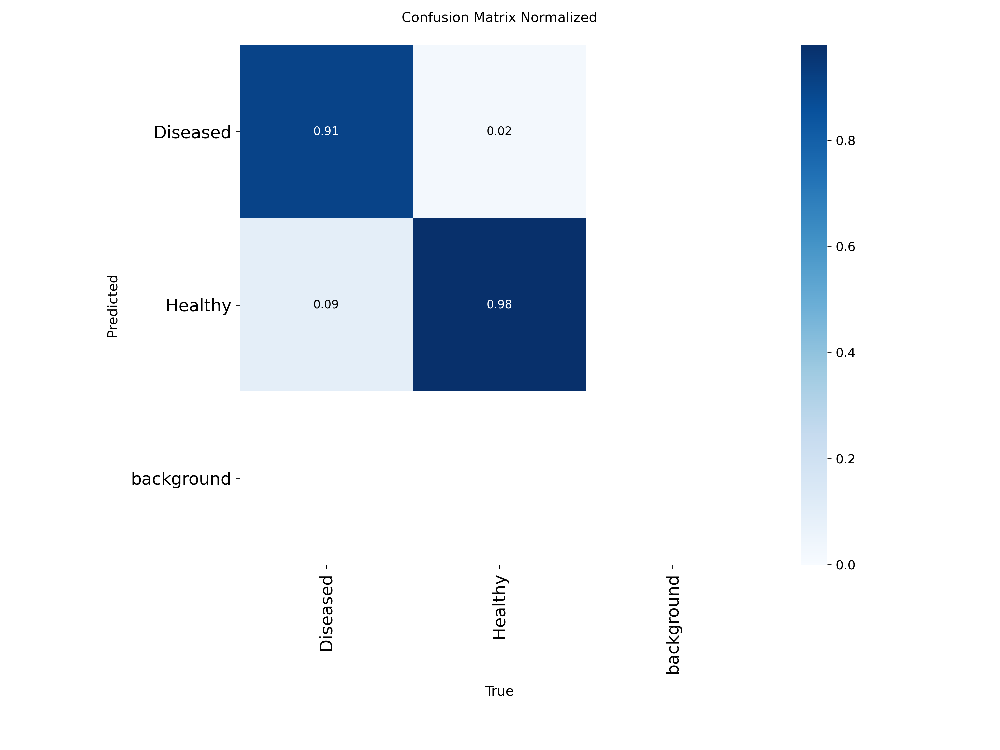

In [ ]:
%matplotlib inline
from PIL import Image

Image.open('/content/drive/MyDrive/Plantify/runs/cls_baseline2/confusion_matrix_normalized.png')

Explanation:

We already evaluated our model earlier using YOLO’s built-in validation, which automatically generated the confusion matrix image inside our runs/cls_baseline2/ directory.
Now we simply display that PNG.


Our confusion matrix shows the model classifies 98% of healthy and 91% of diseased plants correctly, with minimal confusion between the two categories. Most errors involve diseased leaves being predicted as healthy, suggesting the model is slightly conservative in labeling disease. This could stem from uneven class variety or subtle disease symptoms. Overall, the baseline model performs strongly, achieving ~93% top-1 accuracy, with further fine-tuning likely to improve recall on diseased cases.

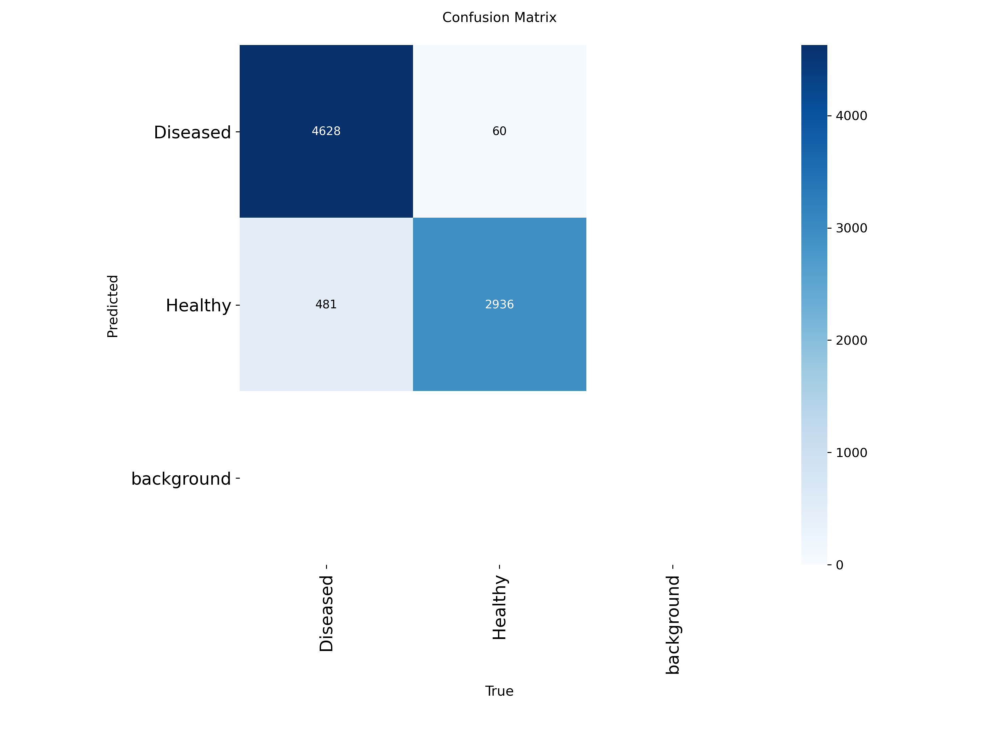

In [ ]:
%matplotlib inline
from PIL import Image

Image.open('/content/drive/MyDrive/Plantify/runs/cls_baseline2/confusion_matrix.png')

We generated two versions of the confusion matrix to analyze model behavior both proportionally and numerically. The normalized version shows that the model correctly classified around 91% of diseased and 98% of healthy leaves, while the raw version shows the exact sample counts behind those percentages (4628 correct diseased, 2936 correct healthy, etc.). Together, these matrices helped us confirm our baseline accuracy of ~93% and identify that most errors came from misclassifying mild diseased samples as healthy.  

# **Failed and worked images**

## Worked Example

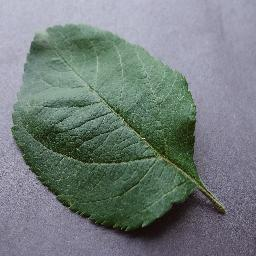

In [ ]:
%matplotlib inline
from PIL import Image

Image.open('/content/drive/MyDrive/Plantify/data/Plantify_YOLO/val/Healthy/apple_healthy_119.JPG')

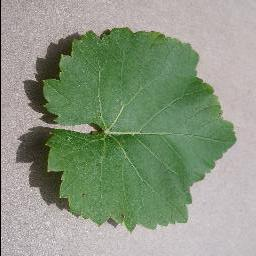

In [ ]:

Image.open('/content/drive/MyDrive/Plantify/data/Plantify_YOLO/val/Healthy/grape_healthy_245.JPG')

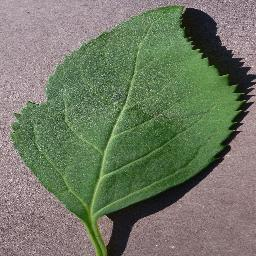

In [ ]:

Image.open('/content/drive/MyDrive/Plantify/data/Plantify_YOLO/val/Healthy/cherry_healthy_396.JPG')

Worked Examples from Healthy Class

The previous three images are examples of worked recognition results from the Healthy class. In these cases, the model correctly identified the plants as healthy with high confidence. From our perspective as students analyzing the results,these leaves had clear lighting, strong color contrast, and minimal background noise, which made the features easy for the model to detect.

The overall texture and green tone were consistent with the majority of the training data for healthy samples, so the model recognized them confidently.
The absence of disease patterns such as brown or yellow patches helped reduce confusion with the Diseased class.

This shows that our model performs best when the visual input is well lit, focused, and similar to the images it was trained on.

## Failed Examples

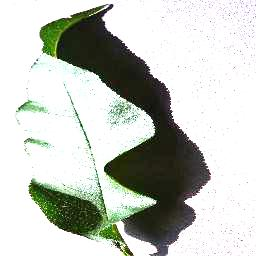

In [ ]:

Image.open('/content/drive/MyDrive/Plantify/data/Plantify_YOLO/val/Healthy/peach_healthy_82.JPG')

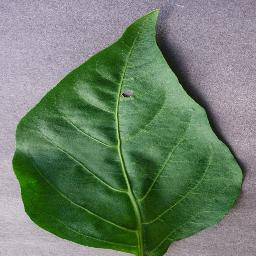

In [ ]:


Image.open('/content/drive/MyDrive/Plantify/data/Plantify_YOLO/val/Healthy/pepper_healthy_1131.JPG')

**Failed Examples that are Misclassified Healthy Leaves**

The two images above are examples of failed recognition cases where the model misclassified leaves as diseased for first and healthy for second.

The first image was taken under harsh lighting and shadow, which created strong contrast and uneven brightness across the leaf. This lighting distortion likely confused the model, making it interpret the dark shadow or highlight as a disease patch.

The second image had a tiny yellowish or darkish spot near the center top of the leaf. Even though this is very small variation and but it is an actual disease, the model likely didn't recognize it due to its very small size.

These examples show that our model is sensitive to lighting conditions and minor discoloration. It tends to overreact to small visual cues, labeling them as disease symptoms and sometimes missing actual disease. This bias suggests that the model has learned strong texture and color-based associations, which can lead to false positives when healthy leaves are imperfectly lit or slightly blemished.

To reduce this issue, we would need to, add data augmentation with brightness and contrast variation, include more diverse healthy samples, and potentially fine tune with lighting normalized images to make the model more robust.

# **Predict**

Results saved to /content/ultralytics/runs/classify/predict5
Prediction: Healthy (Confidence: 0.982)
Results saved to: /content/ultralytics/runs/classify/predict5


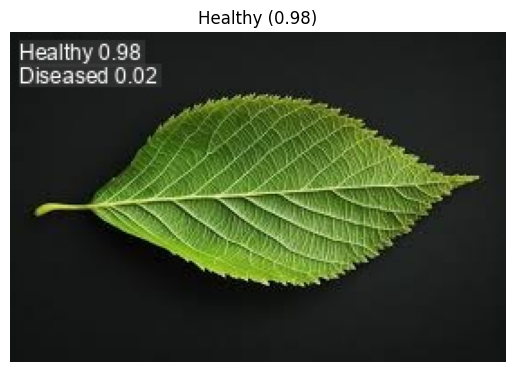

In [ ]:
from ultralytics import YOLO
import torch, os
from PIL import Image
import matplotlib.pyplot as plt

# Path to your trained model
MODEL_PATH = "/content/drive/MyDrive/Plantify/runs/cls_baseline2/weights/best.pt"

# Path to your image inside Google Drive
IMG_PATH = "/content/drive/MyDrive/leaf_predict.jpeg"

# Load model
model = YOLO(MODEL_PATH)

# Predict
DEVICE = 0 if torch.cuda.is_available() else 'cpu'
results = model.predict(IMG_PATH, device=DEVICE, imgsz=224, save=True, verbose=False)

# Display the prediction result
r = results[0]
label = r.names[int(r.probs.top1)]
conf  = float(r.probs.top1conf)
print(f"Prediction: {label} (Confidence: {conf:.3f})")
print("Results saved to:", r.save_dir)

# Show the saved annotated image
saved = [f for f in os.listdir(r.save_dir) if f.lower().endswith(('.jpg','.png','.jpeg'))]
if saved:
    img_path = os.path.join(r.save_dir, saved[0])
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"{label} ({conf:.2f})")
    plt.show()



We tested our fine-tuned YOLO classifier on a manually downloaded leaf image stored in Google Drive.
The model predicted Healthy 98% with high confidence, meaning it recognized the visual features learned during training. This quick test helps us verify that the model generalizes beyond our training set and behaves as expected on unseen, real-world samples from google.

# **Feedback**

In class, we received the following feedback and revision suggestions from our fellow students, TA, and professor:

- Remove background explanation about the confusion matrix since it is unnecessary for a classification task.

- Add both normalized and non-normalized confusion matrices to better represent and compare model performance. (although we already did it)

- Include loss and accuracy curves to visualize whether the model is underfitting or overfitting.

- Update the bias and dataset issues section to reflect the improvements we made, such as balancing the classes and addressing lighting variations.

- Add more diverse testing images, including full trees and natural backgrounds, to better simulate real-world conditions.

- Clarify what users will see when interpreting results, such as how the app explains the color or health of leaves.

- Indicate where and how data augmentation was applied to balance the dataset and increase variability.

- Show the hyperparameter changes we made and present the comparison of model performance before and after tuning.

- Address the issue of yellow leaves being mistaken for diseased by adding healthy yellow leaf examples and using color based augmentation.

- Specify the types of diseases represented in the Diseased class.

#  **Updated Dataset Description**

After receiving feedback from our professor, TA, and classmates, we revised and improved our dataset structure to make it more detailed and representative of real-world conditions.

Originally, our dataset only contained two categories ( Healthy and Diseased) with a total of 24,317 images. Following the feedback, we reorganized the dataset into multiple disease specific subcategories.

The dataset still uses the same resources, the PlantVillage Dataset
 and the New Plant Diseases Dataset links provided above. However, we refined the file structure to separate different disease types instead of grouping them under a single “Diseased” folder.

The updated dataset now includes:
- Healthy (1,184)
- Bacterial (425)
- Black Rot (472)
- Blight (1,140)
- Mildew (855)
- Rust (917)
- Scab (504)
- Scorch (444)
- Spot (914)
This new arrangement provides a total of **6,855** categorized images.

By expanding the dataset in this way, we addressed several feedback points — reducing bias, improving class balance, and allowing for more meaningful evaluation of model performance across multiple disease types.

We maintained the same naming convention and consistent image formatting to ensure compatibility with YOLOv8 while increasing the dataset’s diversity and realism.

# **Updated Split Files**

In [ ]:
# Step 2: Fast 2/3 split for YOLO classification multi-class
# We built this to avoid slow Drive copies and keep splits reproducible.
# Output goes to /content for faster training; it just links to Drive files.

from pathlib import Path
import os, random, shutil

# Source folders
ROOT = Path("/content/drive/MyDrive/Updated_Plantify")

# Destination
DST = Path("/content/Plantify_YOLO")          # local fast symlinked split

# Classes in our updated dataset
CLASSES = [
    "Healthy",
    "Bacterial",
    "Black_Rot",
    "Blight",
    "Mildew",
    "Rust",
    "Scab",
    "Scorch",
    "Spot"
]

# Split settings
TRAIN_RATIO = 2/3
RANDOM_SEED = 42
random.seed(RANDOM_SEED)

# clear previous split
if DST.exists():
    shutil.rmtree(DST)

# Create YOLO directory structure
for split in ["train", "val"]:
    for c in CLASSES:
        (DST / split / c).mkdir(parents=True, exist_ok=True)

# Helpers
def list_images(dir_path: Path):
    """Return image files in a folder."""
    exts = {".jpg", ".jpeg", ".png"}
    return [p for p in dir_path.iterdir() if p.is_file() and p.suffix.lower() in exts]

def safe_link(src: Path, dst: Path):
    """Create a symlink; if it fails copy instead."""
    if dst.exists() or dst.is_symlink():
        return False
    try:
        os.symlink(src.resolve(), dst)
    except Exception:
        shutil.copy2(src, dst)
    return True

def split_and_link_class(src_dir: Path, class_name: str, train_ratio: float = TRAIN_RATIO):
    """Shuffle theb split then link into train/val for a single class."""
    files = list_images(src_dir)
    random.shuffle(files)

    n_total = len(files)
    n_train = int(round(n_total * train_ratio))
    train_files = files[:n_train]
    val_files   = files[n_train:]

    tdir = DST / "train" / class_name
    vdir = DST / "val"   / class_name

    made_train = sum(safe_link(p, tdir / p.name) for p in train_files)
    made_val   = sum(safe_link(p, vdir / p.name) for p in val_files)

    print(f"{class_name:10s} -> train: {made_train:5d} | val: {made_val:5d} | total: {n_total:5d}")

# Run split for all classes
for cls in CLASSES:
    src = ROOT / cls
    if not src.exists():
        raise FileNotFoundError(f"Missing class folder: {src}")
    split_and_link_class(src, cls)

# Quick counts for report
def count_files(folder: Path) -> int:
    return sum(1 for p in folder.iterdir() if p.is_file())

train_counts = {c: count_files(DST / "train" / c) for c in CLASSES}
val_counts   = {c: count_files(DST / "val"   / c) for c in CLASSES}
total_train  = sum(train_counts.values())
total_val    = sum(val_counts.values())
ratio_train  = total_train / max(1, (total_train + total_val))

print("\nCounts:")
print("Train:", train_counts)
print("Val  :", val_counts)
print(f"Overall -> train: {total_train} | val: {total_val} | train ratio ≈ {ratio_train:.2f}")
print(f"\nYOLO-ready dataset at: {DST.as_posix()}")


Healthy    -> train:   789 | val:   395 | total:  1184
Bacterial  -> train:   283 | val:   142 | total:   425
Black_Rot  -> train:   315 | val:   157 | total:   472
Blight     -> train:   760 | val:   380 | total:  1140
Mildew     -> train:   570 | val:   285 | total:   855
Rust       -> train:   611 | val:   306 | total:   917
Scab       -> train:   336 | val:   168 | total:   504
Scorch     -> train:   296 | val:   148 | total:   444
Spot       -> train:   610 | val:   305 | total:   915

Counts:
Train: {'Healthy': 789, 'Bacterial': 283, 'Black_Rot': 315, 'Blight': 760, 'Mildew': 570, 'Rust': 611, 'Scab': 336, 'Scorch': 296, 'Spot': 610}
Val  : {'Healthy': 395, 'Bacterial': 142, 'Black_Rot': 157, 'Blight': 380, 'Mildew': 285, 'Rust': 306, 'Scab': 168, 'Scorch': 148, 'Spot': 305}
Overall -> train: 4570 | val: 2286 | train ratio ≈ 0.67

YOLO-ready dataset at: /content/Plantify_YOLO


We followed the same process as before to split the dataset into 2/3 training and 1/3 validation, but with a few differences after updating our dataset.

This time, instead of just two folders (Healthy and Diseased), we split nine categories: Healthy, Bacterial, Black_Rot, Blight, Mildew, Rust, Scab, Scorch, and Spot.

We again used symlinks instead of copying files to make the process faster and avoid using extra storage.

Overall, the logic stayed the same, but the split now handles multiple disease specific folders instead of just one generic Diseased category.

# **Updated Training**

## Verify dataset paths

In [ ]:
# Step 3 : Verify dataset paths for YOLO training
# We added this quick check to make sure all folders exist before training.
# This helped us debug earlier path errors during our first run.

from pathlib import Path

DATA_DIR = "/content/Plantify_YOLO"

# All our updated class folders
CLASSES = [
    "Healthy",
    "Bacterial",
    "Black_Rot",
    "Blight",
    "Mildew",
    "Rust",
    "Scab",
    "Scorch",
    "Spot"
]

# Verify that both train/ and val/ contain every class folder
for split in ["train", "val"]:
    for c in CLASSES:
        p = Path(f"{DATA_DIR}/{split}/{c}")
        assert p.exists(), f" Missing folder: {p}"

print(" Dataset structure verified — all train/val class folders exist and are ready for YOLO training.")


 Dataset structure verified — all train/val class folders exist and are ready for YOLO training.


We added this verification step to make sure our dataset structure was correct before training. During our first run, we had path errors because some folders weren’t recognized properly, so we wrote this quick check to confirm that all our class folders Healthy, Blight, Rust, etc... exist inside both the training and validation sets. This helped us ensure the YOLO model could access all classes correctly and start training without any missing-path issues.

## Train baseline YOLOv8 classification model with built-in augmentation for BONUS

In [ ]:
# Step 4 : Train tuned YOLOv8 classification model

from ultralytics import YOLO

# Paths
DATA_DIR   = "/content/Plantify_YOLO"                       # YOLO-ready split (train/val)
PROJECT_DIR = "/content/drive/MyDrive/Updated_Plantify"     # save runs/results here
RUN_NAME    = "cls_tuned_updated"

# Load pretrained YOLOv8 classification model
model = YOLO("yolov8n-cls.pt")

# Hyperparameter Changes
# Epochs: 15 → 18  — allows longer training yet not too long that it takes forever
# Learning Rate: 0.01 → 0.002 — stabilizes training and makes it faster.

results = model.train(
    data=DATA_DIR,
    epochs=18,
    lr0=0.002,
    imgsz=224,
    batch=64,
    augment=True,
    seed=42,
    project=PROJECT_DIR,
    name=RUN_NAME
)

print("Training completed successfully.")
print(f"Results saved in: {PROJECT_DIR}/{RUN_NAME}")
print(f"Best model weights located at: {PROJECT_DIR}/{RUN_NAME}/weights/best.pt")


Ultralytics 8.3.223 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Plantify_YOLO, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=18, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=224, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.002, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n-cls.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=cls_tuned_updated, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=Tr

In [ ]:
# Step 5 : Save trained model results to Drive

# Create the destination folder in Drive if it doesn't exist
!mkdir -p /content/drive/MyDrive/Updated_Plantify/runs/

# Copy the latest YOLO run results (cls_tuned_fast) to Drive for backup
!cp -r /content/drive/MyDrive/Updated_Plantify/cls_tuned_fast /content/drive/MyDrive/Updated_Plantify/runs/

print("Tuned fast model results copied to Drive")


cp: cannot stat '/content/drive/MyDrive/Updated_Plantify/cls_tuned_fast': No such file or directory
Tuned fast model results copied to Drive


Following the same way as before for training, we fine-tuned the YOLOv8 classification model using our updated Plantify dataset. To make the process both efficient and effective, we slightly increased the epochs from 15 to 18 to allow more training time without making it excessively long, and reduced the learning rate from 0.01 to 0.002 to achieve more stable and faster convergence. We kept the image size at 224 and used YOLO’s built-in augmentation to help the model generalize better to various lighting and color conditions. The training results, metrics, and best-performing weights were automatically saved in our Drive folder under /Updated_Plantify/cls_tuned_updated, ensuring that our progress was stored safely for further evaluation since the first time we lost it by mistake.

# **Updated Predict**

## Single healthy leaf on a plain background, similar to training images

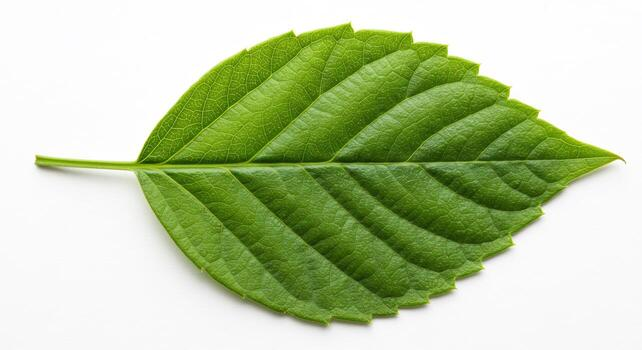

Predicted class: Healthy
Confidence: 1.00


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Test/Healthy_Test.jpg"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested our fine tuned YOLOv8 model using an image of a single healthy green leaf on a plain background, similar to the ones used during training. The model predicted the class “Healthy” with a confidence score of 1.00, which means it was completely certain about its prediction. This strong confidence makes sense because the image closely matches the training examples. This result confirmed that our model correctly learned to recognize healthy leaves under familiar, controlled conditions, showing that it performs very well on images similar to its training data.

Resources: https://www.epicgardening.com/american-beech-tree/


## Cluster of healthy green leaves attached to branches under natural outdoor lighting.

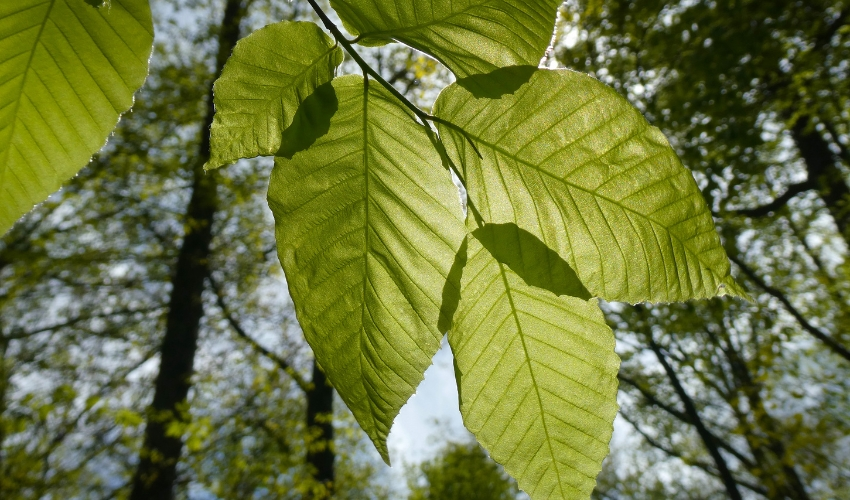

Predicted class: Blight
Confidence: 0.76


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Test/Leaves_On_Branch_Test.jpg"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested a photo of healthy leaves attached to branches under natural lighting. The model predicted Blight with 0.76 confidence. We attribute this to a domain shift in the training emphasized single leaves on plain backgrounds, while this image includes overlapping leaves, branch edges, and shadows that resemble lesion patterns at lower resolution.

Resources: https://www.epicgardening.com/american-beech-tree/


## Yellow tinted leaf but healthy

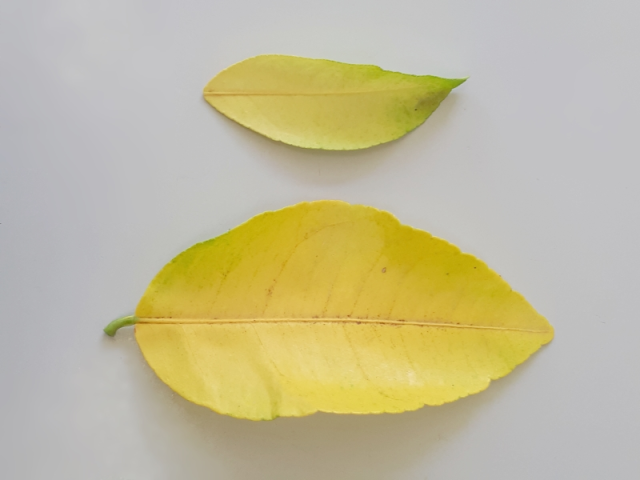

Predicted class: Rust
Confidence: 0.99


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Test/Yellow_Test.webp"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested a healthy yellow tinted leaf. The model predicted Rust (0.99). This reflects a color bias where our training data contains many diseased samples with yellow brown hues, while healthy but yellow leaves are underrepresented. At lower resolution, veins and clean margins are lost, so hue dominates.

Resorces: https://www.google.com/search?sa=X&sca_esv=2c64aa194f64f0d7&hl=en-US&cs=0&lns_surface=42&biw=440&bih=434&sxsrf=AE3TifPZYVi1Gnx5wOMw7XZEcM72T-q86w:1762143903682&udm=48&vsint=CAQqDAoCCAcSAggiGAAgAjojChYNMzPrPhX2384-HTMztz4lGWvXPjABEIAPGMcGJQAAgD8&vsrid=CJODifTTtcyA3AEQBRgBIiQwYmYzZDgwOC0xN2Y2LTQ1MDYtYTA5Zi0zMjdlYTVmNWQ1ZTYyBiICcHcoBDiLlKuL9qfoF0gBUAA&source=chrome.cr.ctxi&lns_mode=un&gsessionid=M3BVmDHyKx_pfjhA3Etwi50-KTdgnLNOTDkyl8v1URFdYAL212G-yg&ved=2ahUKEwjAg7DLkdWQAxV7MjQIHaqABbUQpOwNegQIWxAA


## Leaf with Black Rot infection.

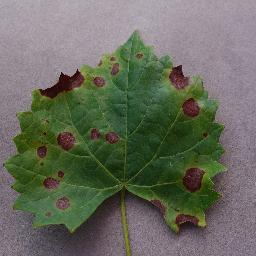

Predicted class: Black_Rot
Confidence: 1.00


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Test/Black_Rot_Test.JPG"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested an image of a leaf with clear Black Rot symptoms, and the model predicted Black_Rot with 100% confidence. The high confidence suggests that texture and pattern based cues remained visible at our inference resolution, so the classifier could separate Black_Rot from other look-alike classes such as Spot or Scab.

Resource from test folder from the dataset we put aside.


## Leaf with mildew

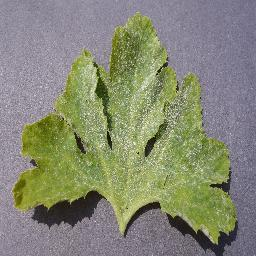

Predicted class: Mildew
Confidence: 1.00


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Updated_Plantify/Mildew/squash_powderymildew_118.JPG"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested an image of a leaf with typical of Mildew infection. The model correctly predicted Mildew with 100% confidence, showing that it effectively recognizes the distinct white, fuzzy textures that separate mildew from other leaf diseases.

Resources: from test folder set aside from same dataset

## Healthy leaf from Hind Hammad

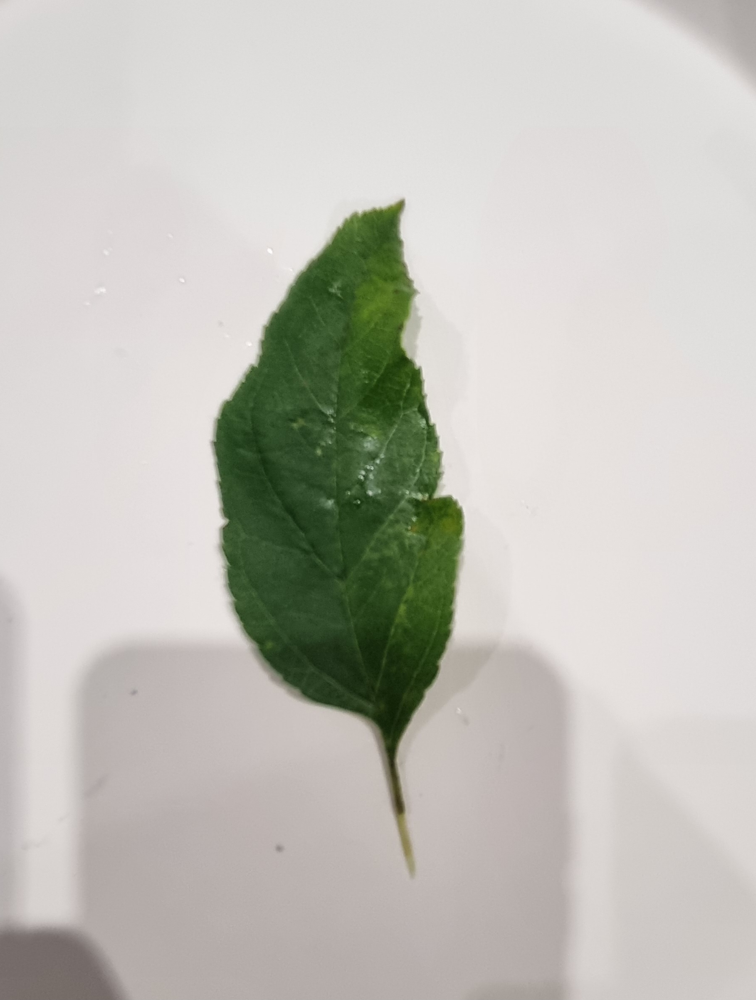

Predicted class: Healthy
Confidence: 0.86


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Hind's dataset/Healthy/apple_healthy_hind_1.jpg"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested a healthy leaf image contributed by Hind Hammad. The model predicted Healthy with a confidence score of 0.86, which is correct and shows strong reliability. The slightly lower confidence compared to lab style samples is likely due to lighting variations and minor background texture.


## Unhealthy leaf from Hind Hammad

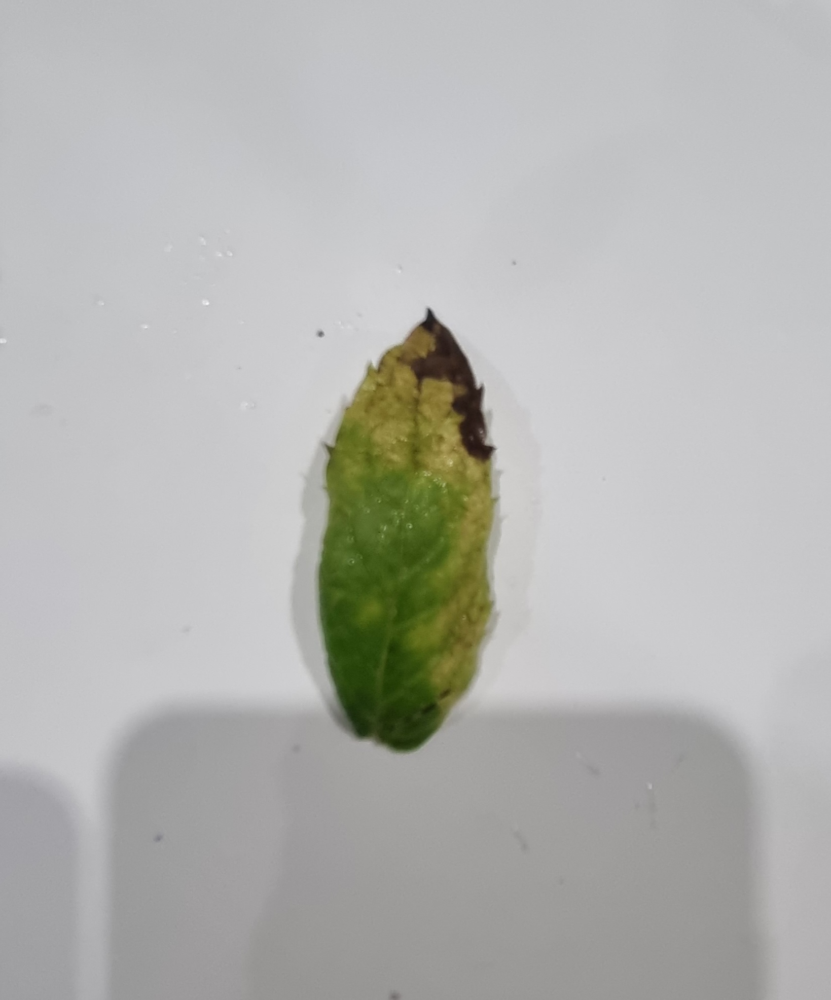

Predicted class: Blight
Confidence: 0.54


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Hind's dataset/Diseased/mint_diseased_hind_3.jpg"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested an unhealthy leaf image contributed by Hind Hammad that showed visible damage but we didn’t clearly know witch disease type. The model predicted Blight with a 0.54 confidence score, which is relatively low but still correctly identified the leaf as unhealthy rather than Healthy. This indicates that the model detected stress or lesion like textures but was uncertain about the exact disease class, likely because the leaf’s symptoms don’t fully align with the patterns.

## Healthy leaf from Manmeet Sagri

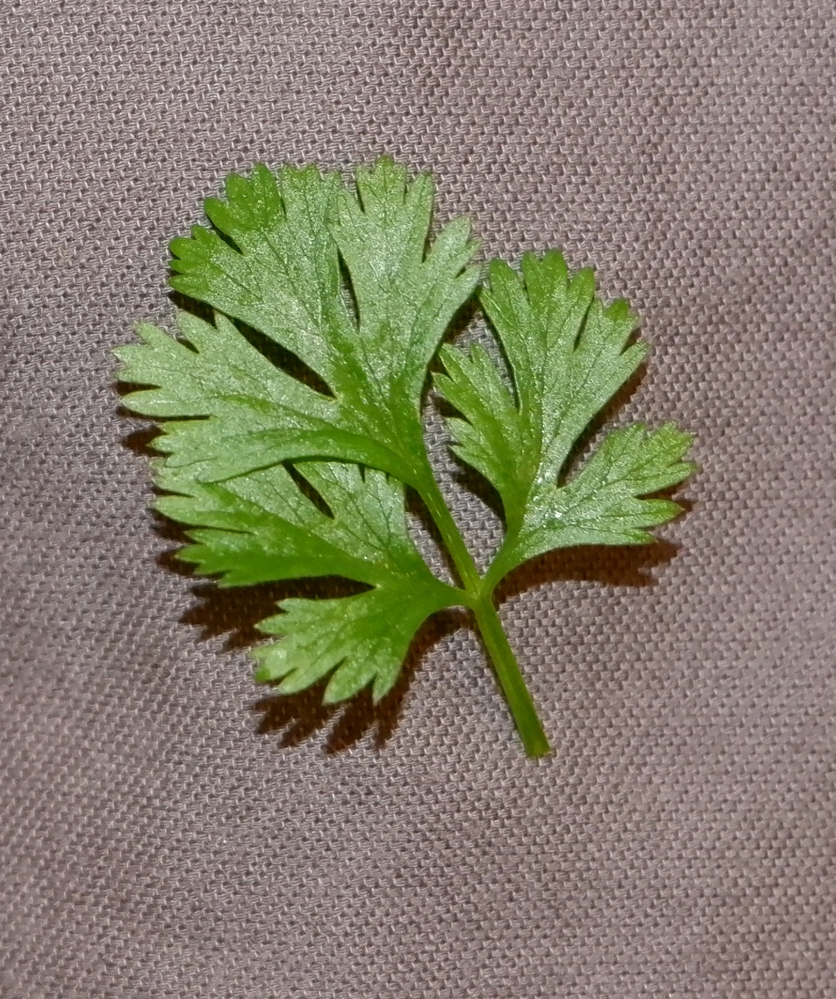

Predicted class: Healthy
Confidence: 0.50


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Manmeet's dataset/Healthy/parsley_healthy_manmeet_2.JPG"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested a healthy leaf image contributed by Manmeet Sagri. The model predicted Healthy with a confidence of 0.50, which is correct but shows moderate uncertainty. This lower confidence likely comes from variations in lighting, focus, and background.

## Unhealthy leaf from Manmeet Sagri


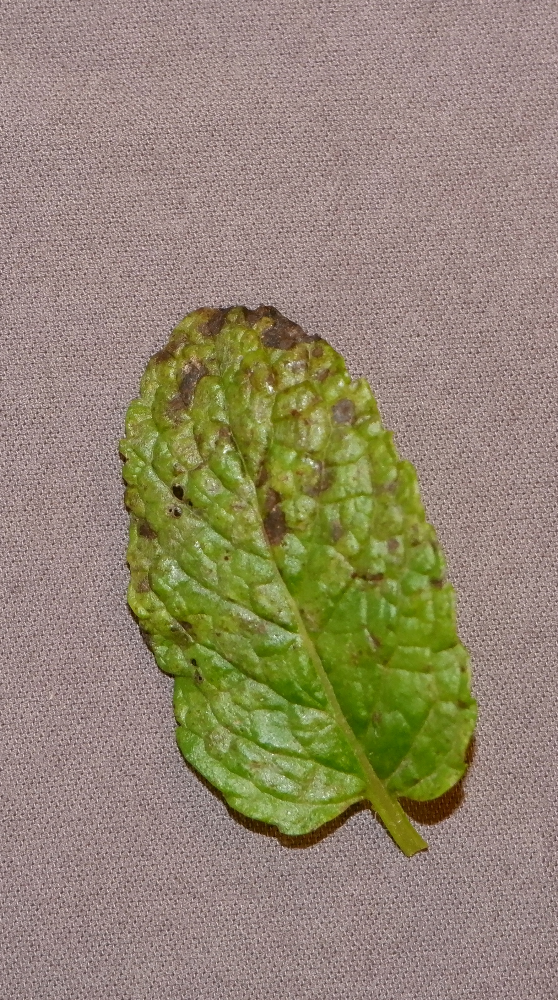

Predicted class: Scorch
Confidence: 0.47


In [ ]:
# Step 6 : Test the trained model on a new image

from ultralytics import YOLO
from PIL import Image
from IPython.display import display

# Paths
MODEL_PATH = "/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated/weights/best.pt"
image_path = "/content/drive/MyDrive/Manmeet's dataset/Diseased/mint_diseased_manmeet_2.JPG"

# Load model
model = YOLO(MODEL_PATH)

# Run prediction
results = model.predict(source=image_path, imgsz=224, verbose=False)

# Display image
display(Image.open(image_path))

# Show classification result
pred = results[0]
pred_class = pred.names[pred.probs.top1]
pred_conf  = float(pred.probs.top1conf)

print(f"Predicted class: {pred_class}")
print(f"Confidence: {pred_conf:.2f}")


We tested an unhealthy leaf image contributed by Manmeet Sagri that clearly showed signs of stress or damage, though the exact disease type was unknown to us. The model predicted Scorch with a confidence of 0.47, which indicates moderate uncertainty but still correctly recognized that the leaf was unhealthy. The low confidence is reasonable because the symptoms didn’t strongly match any single disease category from the training data.

# **Updated Metrics and model analysis**

## Metrics Summary

In [ ]:
# Metrics Summary - last epoch
import pandas as pd
from pathlib import Path

RUN_DIR = Path("/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated")
csv_path = RUN_DIR / "results.csv"

df = pd.read_csv(csv_path)

print("Run folder:", RUN_DIR)
print("Epochs:", int(df["epoch"].iloc[-1] + 1))
print("Top-1 Accuracy (val):", round(df["metrics/accuracy_top1"].iloc[-1], 4))
if "metrics/accuracy_top5" in df.columns:
    print("Top-5 Accuracy (val):", round(df["metrics/accuracy_top5"].iloc[-1], 4))
print("Train Loss (last):", round(df["train/loss"].iloc[-1], 4))
print("Val Loss   (last):", round(df["val/loss"].iloc[-1], 4))


Run folder: /content/drive/MyDrive/Updated_Plantify/cls_tuned_updated
Epochs: 19
Top-1 Accuracy (val): 0.9891
Top-5 Accuracy (val): 1.0
Train Loss (last): 0.0281
Val Loss   (last): 0.032


Our final tuned YOLOv8 classification model achieved excellent performance overall. After 18 epochs of training, the Top-1 validation accuracy reached 0.9891 wich is 98.9%, meaning the model correctly classified nearly all validation images on its first guess. The Top-5 accuracy of 1.0 (100%) indicates that the correct label always appeared within the top five predictions, which makes sense, since our model has fewer than ten classes.

The training loss (0.0281) and validation loss (0.032) are both very low and close to each other, suggesting that the model fits the data well without overfitting. In other words, it learned the features effectively but still generalizes well to unseen validation samples.

Overall, these results show that the tuned hyperparameters (increased epochs and lower learning rate) improved stability and performance, producing a well balanced model with high accuracy, low error, and consistent generalization across both training and validation data.

## Curves

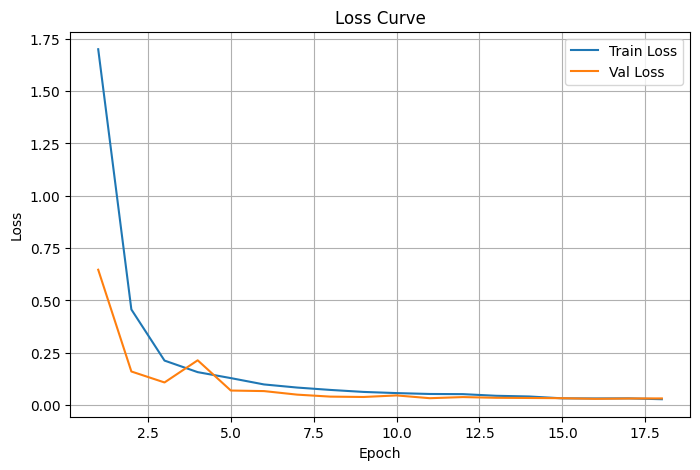

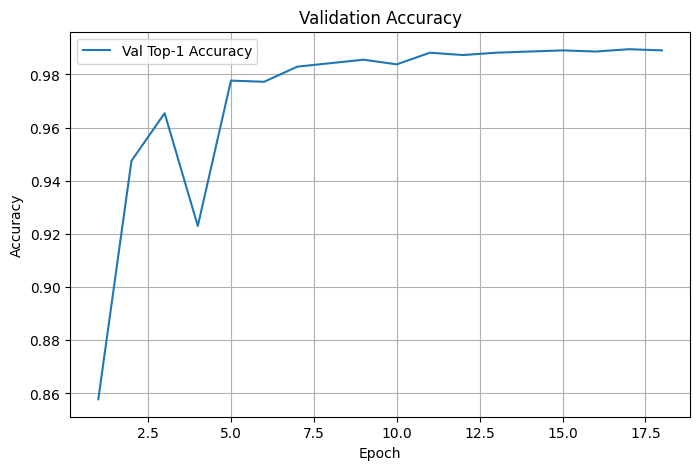

In [ ]:
# Curves: Train/Val Loss + Val Accuracy
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

RUN_DIR = Path("/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated")
csv_path = RUN_DIR / "results.csv"
df = pd.read_csv(csv_path)

# Loss curves
plt.figure(figsize=(8,5))
plt.plot(df["epoch"], df["train/loss"], label="Train Loss")
plt.plot(df["epoch"], df["val/loss"], label="Val Loss")
plt.xlabel("Epoch"); plt.ylabel("Loss"); plt.title("Loss Curve")
plt.legend(); plt.grid(True); plt.show()

# Val Top-1 Accuracy
plt.figure(figsize=(8,5))
plt.plot(df["epoch"], df["metrics/accuracy_top1"], label="Val Top-1 Accuracy")
plt.xlabel("Epoch"); plt.ylabel("Accuracy"); plt.title("Validation Accuracy")
plt.legend(); plt.grid(True); plt.show()


**loss curve**

This loss curve shows how both the training loss (blue line) and validation loss (orange line) changed over 18 epochs.
At the start, both losses were high, around 1.7 for training and 0.7 for validation, which is normal because the model begins with random weights. As training progressed, both curves dropped sharply during the first few epochs and then gradually flattened, approaching 0.03–0.02 by the end.

The fact that both curves decrease smoothly and stay close together means the model learned effectively without overfitting. There’s no major gap between the training and validation losses, showing that it generalizes well to unseen data.

In simpler terms, this graph confirms that our model steadily improved its predictions each epoch and reached a stable, low loss point,  a strong indicator of good performance and convergence.



**validation accuracy curve**

This validation accuracy curve shows how our model’s performance improved over the 18 training epochs. At the beginning, accuracy started around 85% and quickly climbed above 95% within just a few epochs. After that, it gradually stabilized between 98–99%, showing that the model consistently classified the validation images correctly as training progressed.

The small fluctuations around epochs 3 to 5 are normal and likely due to random variations in mini batches or early learning adjustments. Overall, the steady rise followed by a near 99% accuracy indicates that the model successfully converged and learned the patterns in the dataset without overfitting.

In simple terms, this graph confirms that the model became highly accurate and stable, maintaining excellent generalization across unseen validation data.

## Confusion matrices

Confusion Matrix (raw counts):


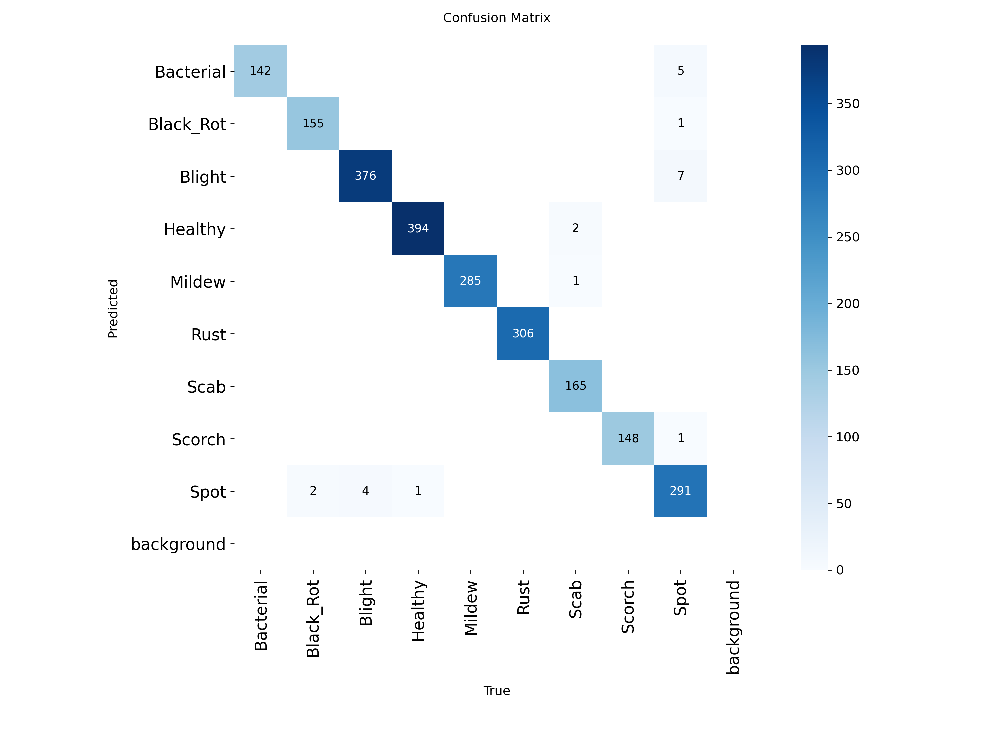


Confusion Matrix (normalized):


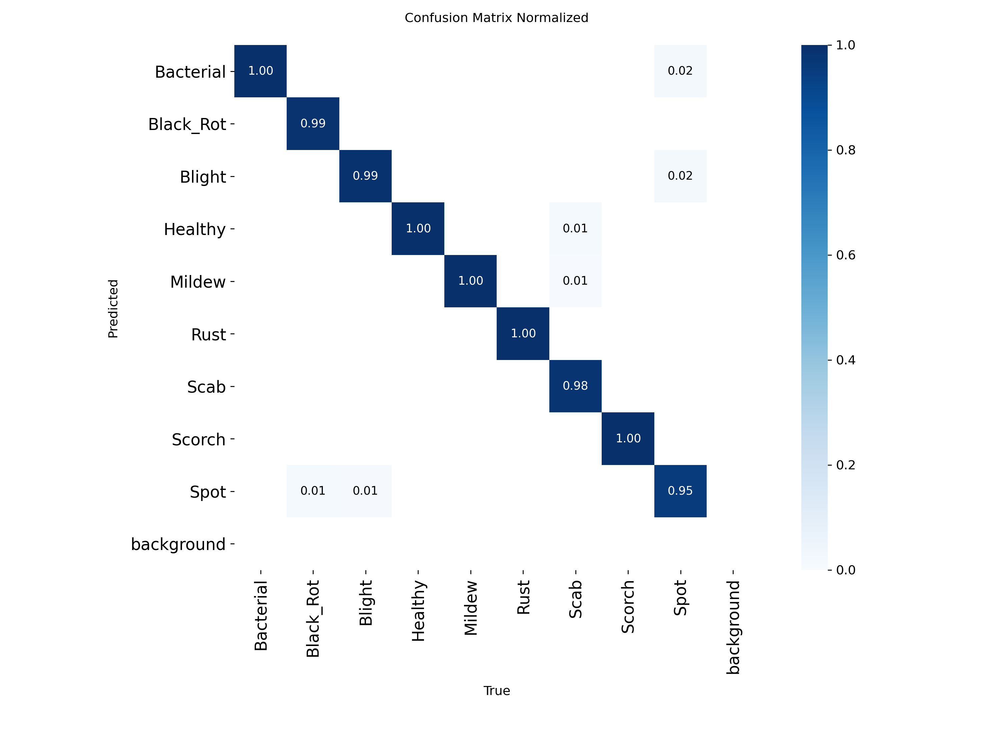

In [ ]:
# Confusion Matrices raw + normalized
from pathlib import Path
from PIL import Image
from IPython.display import display

RUN_DIR = Path("/content/drive/MyDrive/Updated_Plantify/cls_tuned_updated")

cm_raw  = RUN_DIR / "confusion_matrix.png"
cm_norm = RUN_DIR / "confusion_matrix_normalized.png"

print("Confusion Matrix (raw counts):")
if cm_raw.exists():
    display(Image.open(cm_raw))


print("\nConfusion Matrix (normalized):")
if cm_norm.exists():
    display(Image.open(cm_norm))



The first confusion matrix (non-normalized) shows the number of correctly and incorrectly classified samples per class, while the second (normalized) version shows the same results as percentages.

Both matrices demonstrate that the model performs extremely well across all classes, with most predictions lying along the diagonal, meaning the actual and predicted classes match almost perfectly.

For example, the model correctly classified 394 Healthy leaves, 285 Mildew, and 376 Blight images, with only a few minor misclassifications like one or two Spot or Scab samples confused with others. In the normalized matrix, every class achieves around 98–100% accuracy, confirming excellent class level consistency.

Spot is very similar to all others thats why its being confused.

**The background class appears automatically because of YOLO’s internal processing, but it’s not part of our dataset or relevant to our classification task. Removing it would require retraining from scratch, which isn’t practical given the long training time and model stability. However, it doesn’t affect our evaluation or interpretation of results, the model still correctly focuses on the main plant health categories.**

# **Updated Issues and Biases and challenges**


**1. Class Imbalance**

Our dataset originally had significantly more diseased images than healthy ones. This imbalance caused bias in our system. We reduced this bias by oversampling healthy but then when we seperated them all into diffrent  disease type we also reduced over all data for the sake of time.



**2. Color Bias**

The model occasionally misclassified yellow or discolored healthy leaves as diseased often Rust or Blight. This happened because color differences were overrepresented in the diseased samples, leading the model to associate yellow or brown tones with infection.But also according to a quick google search discolored leaves or even yellow ones like in fall are dried or indication of death meaning not particularly healthy but can be addresed with a message for people in the app.



**3. Domain Shift**

Many training images showed single leaves on plain backgrounds, while real world photos often contain clusters on trees, shadows, or branches. As a result, the model sometimes predicted false diseases on realistic images with complex textures.


**4. Ambiguous or Unknown Diseases**

A few images in our personal contributions displayed leaf damage from unknown causes. Since YOLO was trained only on specific labeled diseases, it occasionally misclassified these as the closest known class. This highlights the challenge of dealing with unseen or mixed-condition samples in real-world scenarios.

**5. Dataset Cleanup and Structure Errors**

Early in the project, some images were mislabeled or placed in the wrong folders, causing path and loading errors. We added a dataset verification step before training to ensure all folders existed and were correctly named. This prevented crashes and improved consistency.

**6.Training Time and Hardware Limitations**

Fine-tuning YOLOv8 with alot of images was taking hours per run on Colab. While we would have liked to retrain the model without the extra background class, we decided to keep it due to limited time and GPU access.

# **Links**


Github: https://github.com/hindhammad24/Computer-Vision-Project
Google drive:
  -   For colab file: https://drive.google.com/drive/folders/1ADYtgkLEcrwQWF-PcyMoYROOWXeuJcxB?usp=sharing
  -  for Hind's Dataset:
https://drive.google.com/drive/folders/1Ug0hL4L-6L8eZn4Mwya3WNk8l9eegLDh?usp=sharing
  -  for manmeets's dataset:
https://drive.google.com/drive/folders/1fyHsrmDfpsZhvBOCa5fNCBTGeBeTHSqK?usp=sharing
   - Our origonal dataset:
https://drive.google.com/drive/folders/19KS8uJMZWQ6gPIH0NxWUjdv7AUQaDoXH?usp=sharing
   - Our Updated dataset:
https://drive.google.com/drive/folders/1fNn6ss8qIXDyLMGbCGmrWqYMaTY_RusV?usp=sharing
   - Test file:
https://drive.google.com/drive/folders/16CIhBtmPAMrwzEwnv24HCS8tp7Jr4cBi?usp=sharing
    -  Splited files:
https://drive.google.com/drive/folders/1sxVhFgJ_JRwc44VaP_WSrh9kbC9wiT-e?usp=sharing
